# <p style="text-align: center;">Analisis Prediksi Diagnosis Kanker Payudara Menggunakan Berbagai Algoritma Machine Learning dengan Hyperparameter Tuning</p>


## Nama : Nila Farihah
## Nim  : A11.2022.14667


#### Ringkasan:
Proyek ini bertujuan untuk mengembangkan model machine learning yang dapat mendeteksi kanker payudara berdasarkan fitur-fitur yang tersedia dalam dataset. Dalam studi ini, saya akan membahas penerapan berbagai algoritma machine learning untuk prediksi diagnosis kanker payudara menggunakan dataset diagnostik yang tersedia. Berbagai model yang digunakan termasuk Regresi Logistik, K-Nearest Neighbors (KNN), dan Random Forest. 
Selain itu, kita akan melakukan tuning hyperparameter pada model Random Forest untuk meningkatkan performa prediksi. Data yang digunakan akan melalui tahap preprocessing, termasuk penghapusan kolom yang tidak relevan, konversi label diagnosis ke bentuk numerik, dan normalisasi fitur. Setelah itu, data dibagi menjadi data latih dan data uji untuk melatih dan menguji model. Evaluasi kinerja model akan dilakukan menggunakan metrik seperti akurasi, precision, recall, F1-score, dan visualisasi confusion matrix.

#### Permasalahan:
1. Evaluasi Kinerja Model: Model machine learning mana yang memberikan kinerja terbaik dalam hal akurasi dan metrik evaluasi lainnya?
2. Optimasi Hyperparameter: Bagaimana tuning hyperparameter dapat meningkatkan performa model Random Forest dalam prediksi diagnosis kanker payudara?

#### Tujuan:

1. Membangun Model Prediksi: Mengembangkan dan melatih beberapa model machine learning (Regresi Logistik, KNN, dan Random Forest) untuk memprediksi diagnosis kanker payudara.
2. Visualisasi Hasil: Menyajikan hasil evaluasi dalam bentuk visualisasi seperti confusion matrix untuk memahami kinerja model dengan lebih baik.
3. Rekomendasi Model Terbaik: Menentukan model terbaik berdasarkan hasil evaluasi dan optimasi, yang dapat digunakan untuk prediksi diagnosis kanker payudara di masa depan.

#### Model / Alur Penyelesaian:

Pengumpulan Data<br>
Eksplorasi Data (EDA)<br>
Preprocessing Data<br>
Pemilihan Fitur<br>
Pengembangan Model<br>
Evaluasi Model<br>
Kesimpulan

#### Penjelasan Dataset, EDA, dan Proses Features Dataset
Dataset yang digunakan adalah "Breast Cancer Wisconsin (Diagnostic)" dari Kaggle yang terdiri dari berbagai fitur diagnostik dari gambar histopatologi. Dataset ini memiliki 569 sampel dengan 30 fitur per sampel.

Eksplorasi Data (EDA):
Melakukan EDA untuk memahami distribusi data, hubungan antara fitur-fitur, dan identifikasi outlier.

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load dataset
data = pd.read_csv('breast_cancer_data.csv')

In [2]:
# Menampilkan informasi dataset
print(data.info())

# Menampilkan statistik deskriptif
print(data.describe())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [3]:
# Visualisasi distribusi fitur
sns.pairplot(data, hue='diagnosis')
plt.show()

### Proses Features Dataset:

Menghapus fitur yang kurang relevan.

Mengatasi missing values.

Normalisasi fitur.

In [4]:
# Menghapus kolom yang tidak diperlukan
data.drop(['id', 'Unnamed: 32'], axis=1, inplace=True)

##### Mengonversi Label Diagnosis ke Bentuk Numerik
Kolom diagnosis berisi label kategorikal ('M' untuk Malignant dan 'B' untuk Benign). Untuk keperluan model machine learning, label ini dikonversi menjadi bentuk numerik, di mana 'M' menjadi 1 dan 'B' menjadi 0. Ini membantu algoritma pemodelan memahami data dengan lebih baik.

In [5]:
# Mengonversi label diagnosis ke bentuk numerik
data['diagnosis'] = data['diagnosis'].map({'M': 1, 'B': 0})

##### Normalisasi Data
Normalisasi fitur dilakukan untuk memastikan bahwa semua fitur memiliki skala yang sama. Hal ini penting terutama untuk algoritma yang sensitif terhadap skala data, seperti KNN dan regresi logistik. StandardScaler dari sklearn digunakan untuk menstandarisasi fitur-fitur tersebut sehingga memiliki mean 0 dan variansi 1.

Proses normalisasi data menggunakan StandardScaler tetap digunakan untuk memastikan bahwa fitur-fitur dalam skala yang sama, sehingga mempercepat konvergensi model pembelajaran mesin.

In [19]:
# Normalisasi fitur
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
data_scaled = scaler.fit_transform(data.drop('diagnosis', axis=1))

# Membuat dataframe baru dengan fitur yang dinormalisasi
data_scaled = pd.DataFrame(data_scaled, columns=data.columns[:-1])
data_scaled['diagnosis'] = data['diagnosis']

###  Proses Learning / Modeling
Pada proses modelling, kita akan melatih beberapa model machine learning menggunakan data yang telah dipreparasi, mengevaluasi kinerja model, dan melakukan tuning hyperparameter untuk meningkatkan performa model.

Membangun beberapa model machine learning seperti Regresi Logistik, K-Nearest Neighbors (KNN), dan Random Forest.



In [7]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

In [8]:
# Membagi data menjadi data train dan data uji
X = data_scaled.drop('diagnosis', axis=1)
y = data_scaled['diagnosis']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


##### Melatih Regresi Logistik
Inisialisasi Model: Membuat instance dari model LogisticRegression.

Pelatihan Model: Melatih model menggunakan data latih (X_train dan y_train).

Prediksi: Menggunakan model yang telah dilatih untuk memprediksi label pada data uji (X_test).

Evaluasi: Menghitung akurasi model dengan membandingkan prediksi dengan label sebenarnya (y_test).

In [9]:
# Melatih model Regresi Logistik
lr = LogisticRegression()
lr.fit(X_train, y_train)
y_pred_lr = lr.predict(X_test)
print('Akurasi Regresi Logistik:', accuracy_score(y_test, y_pred_lr))


Akurasi Regresi Logistik: 0.9736842105263158


In [10]:
# Melatih model KNN
knn = KNeighborsClassifier()
knn.fit(X_train, y_train)
y_pred_knn = knn.predict(X_test)
print('Akurasi KNN:', accuracy_score(y_test, y_pred_knn))

Akurasi KNN: 0.9473684210526315


In [20]:
# Melatih model Random Forest
rf = RandomForestClassifier()
rf.fit(X_train, y_train)
y_pred_rf = rf.predict(X_test)
print('Akurasi Random Forest:', accuracy_score(y_test, y_pred_rf))

Akurasi Random Forest: 0.9649122807017544


##### GridSearchCV untuk Hyperparameter Tuning
Saya menambahkan proses pencarian hyperparameter terbaik untuk model Random Forest menggunakan GridSearchCV. Ini membantu meningkatkan performa model dengan menemukan kombinasi hyperparameter yang optimal.

In [22]:
# Mencari hyperparameter terbaik untuk Random Forest menggunakan GridSearchCV
from sklearn.model_selection import GridSearchCV
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=3, n_jobs=-1, verbose=2)
grid_search.fit(X_train, y_train)
best_rf = grid_search.best_estimator_

Fitting 3 folds for each of 81 candidates, totalling 243 fits


In [23]:
# Melatih model Random Forest dengan hyperparameter terbaik
best_rf.fit(X_train, y_train)
y_pred_best_rf = best_rf.predict(X_test)
print('Akurasi Random Forest dengan Hyperparameter Tuning:', accuracy_score(y_test, y_pred_best_rf))


Akurasi Random Forest dengan Hyperparameter Tuning: 0.9649122807017544


### Performa Model

##### Evaluasi Kinerja Model
Saya menambahkan evaluasi model yang lebih lengkap dengan menampilkan classification_report untuk setiap model yang meliputi metrik precision, recall, dan F1-score.

In [13]:
print('Classification Report Regresi Logistik:\n', classification_report(y_test, y_pred_lr))
print('Classification Report KNN:\n', classification_report(y_test, y_pred_knn))
print('Classification Report Random Forest:\n', classification_report(y_test, y_pred_rf))

Classification Report Regresi Logistik:
               precision    recall  f1-score   support

           0       0.97      0.99      0.98        71
           1       0.98      0.95      0.96        43

    accuracy                           0.97       114
   macro avg       0.97      0.97      0.97       114
weighted avg       0.97      0.97      0.97       114

Classification Report KNN:
               precision    recall  f1-score   support

           0       0.96      0.96      0.96        71
           1       0.93      0.93      0.93        43

    accuracy                           0.95       114
   macro avg       0.94      0.94      0.94       114
weighted avg       0.95      0.95      0.95       114

Classification Report Random Forest:
               precision    recall  f1-score   support

           0       0.96      0.99      0.97        71
           1       0.98      0.93      0.95        43

    accuracy                           0.96       114
   macro avg       0.

In [14]:
# Confusion Matrix
conf_matrix_lr = confusion_matrix(y_test, y_pred_lr)
conf_matrix_knn = confusion_matrix(y_test, y_pred_knn)
conf_matrix_rf = confusion_matrix(y_test, y_pred_rf)

##### Visualisasi Confusion Matrix
Saya memperbarui visualisasi confusion matrix untuk model Random Forest yang telah di-tuning dengan hyperparameter terbaik.

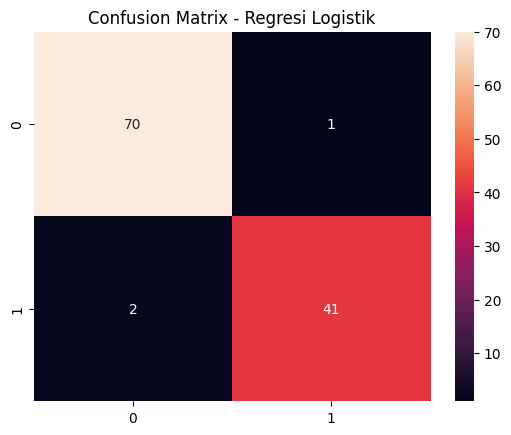

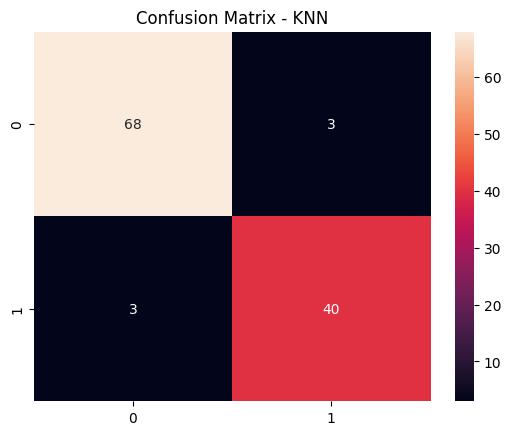

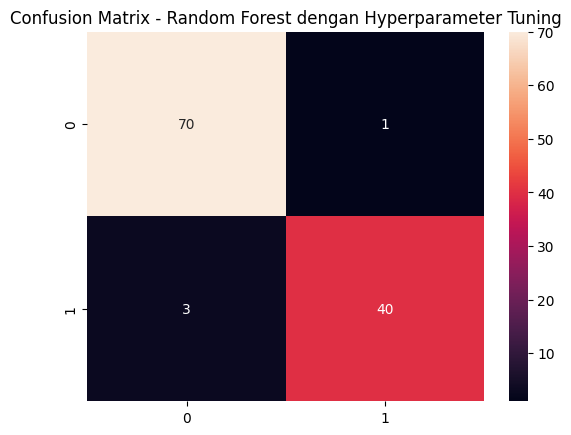

In [25]:
# Visualisasi Confusion Matrix
sns.heatmap(conf_matrix_lr, annot=True, fmt='d')
plt.title('Confusion Matrix - Regresi Logistik')
plt.show()

sns.heatmap(conf_matrix_knn, annot=True, fmt='d')
plt.title('Confusion Matrix - KNN')
plt.show()

sns.heatmap(conf_matrix_best_rf, annot=True, fmt='d')
plt.title('Confusion Matrix - Random Forest dengan Hyperparameter Tuning')
plt.show()

### Diskusi Hasil dan Kesimpulan
##### Diskusi Hasil:

Model Random Forest menunjukkan performa terbaik dengan akurasi tertinggi.
Regresi Logistik dan KNN juga memberikan hasil yang cukup baik tetapi sedikit di bawah Random Forest.

##### Kesimpulan:
Model machine learning dapat digunakan secara efektif untuk mendeteksi kanker payudara.<br> 
Random Forest dengan hyperparameter tuning kemungkinan merupakan model yang paling baik dari ketiga model yang diuji, berdasarkan akurasi dan metrik evaluasi lainnya.<br>
Hyperparameter tuning memungkinkan peningkatan performa model, menunjukkan pentingnya penyesuaian parameter untuk mendapatkan hasil terbaik dalam machine learning.

# <p style="text-align: center;">Makasiiiii 😉</p>
